# <font color = "red"> If you like this kernel. Then appreciate me with an upvote</font>

# PRETRAINED VGG MODEL IS USED IN THIS KERNEL GOT ACCURACY OVER 90% - 95%

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
        break

# You can write up to 5GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/agriculture-crop-images/Crop_details.csv
/kaggle/input/agriculture-crop-images/test_crop_image/maize000.jfif
/kaggle/input/agriculture-crop-images/some_more_images/some_more_images/jute/jute041a.jpg
/kaggle/input/agriculture-crop-images/some_more_images/some_more_images/maize/maize042a.jpg
/kaggle/input/agriculture-crop-images/some_more_images/some_more_images/Wheat/wheat044a.jpg
/kaggle/input/agriculture-crop-images/some_more_images/some_more_images/sugarcane/sugarcane048a.jpg
/kaggle/input/agriculture-crop-images/some_more_images/some_more_images/rice/rice041a.jpg
/kaggle/input/agriculture-crop-images/crop_images/jute/jute025a.jpeg
/kaggle/input/agriculture-crop-images/crop_images/maize/maize034a.jpeg
/kaggle/input/agriculture-crop-images/crop_images/wheat/wheat024a.jpeg
/kaggle/input/agriculture-crop-images/crop_images/sugarcane/sugarcane038a.jpeg
/kaggle/input/agriculture-crop-images/crop_images/rice/rice025a.jpeg
/kaggle/input/agriculture-crop-images/kag2/jute/jute02

# Loading modules

In [2]:
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf 
import keras 
from keras.layers import Conv2D
from keras.models import Sequential
from keras.layers import MaxPool2D
from keras.layers import Flatten
from keras.layers import Dense
from keras.models import Model
from keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
import cv2
import re
import random
random.seed(0)
np.random.seed(0)

# Plotting some images

Text(0.5, 1.0, 'wheat')

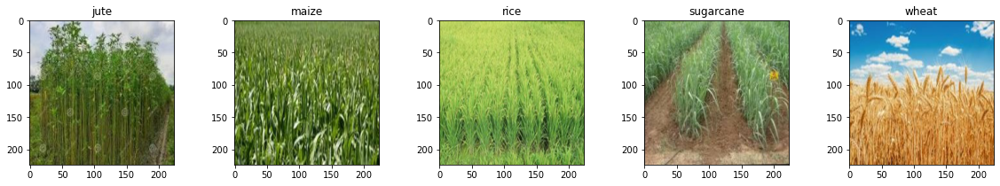

In [3]:
wheat = plt.imread("/kaggle/input/agriculture-crop-images/kag2/wheat/wheat0004a.jpeg")
jute = plt.imread("/kaggle/input/agriculture-crop-images/kag2/jute/jute005a.jpeg")
cane = plt.imread("/kaggle/input/agriculture-crop-images/kag2/sugarcane/sugarcane0010arot.jpeg")
rice = plt.imread("/kaggle/input/agriculture-crop-images/kag2/rice/rice032ahs.jpeg")
maize = plt.imread("/kaggle/input/agriculture-crop-images/kag2/maize/maize003a.jpeg")
plt.figure(figsize=(20,3))
plt.subplot(1,5,1)
plt.imshow(jute)
plt.title("jute")
plt.subplot(1,5,2)
plt.imshow(maize)
plt.title("maize")
plt.subplot(1,5,3)
plt.imshow(rice)
plt.title("rice")
plt.subplot(1,5,4)
plt.imshow(cane)
plt.title("sugarcane")
plt.subplot(1,5,5)
plt.imshow(wheat)
plt.title("wheat")

# Converting to training and testing data

In [4]:
jutepath = "../input/agriculture-crop-images/kag2/jute"
maizepath = "../input/agriculture-crop-images/kag2/maize"
ricepath = "../input/agriculture-crop-images/kag2/rice"
sugarcanepath = "../input/agriculture-crop-images/kag2/sugarcane"
wheatpath = "../input/agriculture-crop-images/kag2/wheat"

jutefilename = os.listdir(jutepath)
maizefilename = os.listdir(maizepath)
ricefilename = os.listdir(ricepath)
sugarcanefilename = os.listdir(sugarcanepath)
wheatfilename = os.listdir(wheatpath)

X= []

In [5]:
for fname in jutefilename:
    X.append([os.path.join(jutepath,fname),0])
for fname in maizefilename:
    X.append([os.path.join(maizepath,fname),1])
for fname in ricefilename:
    X.append([os.path.join(ricepath,fname),2])
for fname in sugarcanefilename:
    X.append([os.path.join(sugarcanepath,fname),3]) 
for fname in wheatfilename:
    X.append([os.path.join(wheatpath,fname),4])  
X = pd.DataFrame(X,columns = ['path','labels'])    

In [6]:
X.head()

,path,labels
0,../input/agriculture-crop-images/kag2/jute/jut...,0
1,../input/agriculture-crop-images/kag2/jute/jut...,0
2,../input/agriculture-crop-images/kag2/jute/jut...,0
3,../input/agriculture-crop-images/kag2/jute/jut...,0
4,../input/agriculture-crop-images/kag2/jute/jut...,0


In [7]:

ohencoder = OneHotEncoder(handle_unknown='ignore',sparse=False)
ohlabel = pd.DataFrame(ohencoder.fit_transform(X[['labels']]),dtype = 'float64',columns = ['label0','label1','label2','label3','label4'])
label_X = X.copy()
X = pd.concat([X,ohlabel],axis = 1)
new_X = X.drop(['labels'],axis = 1)

In [8]:
train,test = train_test_split(new_X,test_size=0.2,random_state=32,shuffle = True)

In [9]:
X_train = train['path'].values
y_train = train.drop(['path'],axis=1).values
X_test = test['path'].values
y_test = test.drop(['path'],axis=1).values

In [10]:
def deep_pipeline(data):
    flat = []
    for i in data:
        img = plt.imread(i)
        img = img/255.
        flat.append(img)
    flat =  np.array(flat)    
    flat = flat.reshape(-1,224,224,3)       
    return flat
    

In [11]:
dx_train = deep_pipeline(X_train)
dx_test = deep_pipeline(X_test)

# Model training

In [12]:
keras.backend.clear_session()
vgg = keras.applications.VGG19(input_shape=(224,224,3),include_top=False,weights = 'imagenet',pooling='avg')
vgg.trainable = False
vggmodel = keras.Sequential([vgg
                         ,Dense(1000,activation='tanh'),Dense(1000,activation='tanh'),Dense(1000,activation='tanh'),Dense(5,activation='softmax')])

vggmodel.compile(optimizer = 'adam',loss = 'categorical_crossentropy',metrics=['accuracy'])
vggmodel.summary()

80142336/80134624 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 512)               20024384  
_________________________________________________________________
dense (Dense)                (None, 1000)              513000    
_________________________________________________________________
dense_1 (Dense)              (None, 1000)              1001000   
_________________________________________________________________
dense_2 (Dense)              (None, 1000)              1001000   
_________________________________________________________________
dense_3 (Dense)              (None, 5)                 5005      
Total params: 22,544,389
Trainable params: 2,520,005
Non-trainable params: 20,024,384
_________________________________________________________________


In [13]:
hist = vggmodel.fit(dx_train,y_train,epochs=50,validation_split=0.3,batch_size=16)

Epoch 1/50
29/29 [==============================] - 3s 111ms/step - loss: 2.7336 - accuracy: 0.3044 - val_loss: 1.6350 - val_accuracy: 0.3212
Epoch 2/50
29/29 [==============================] - 2s 75ms/step - loss: 1.2121 - accuracy: 0.5089 - val_loss: 0.9382 - val_accuracy: 0.6528
Epoch 3/50
29/29 [==============================] - 2s 76ms/step - loss: 1.0692 - accuracy: 0.5911 - val_loss: 0.8585 - val_accuracy: 0.6839
Epoch 4/50
29/29 [==============================] - 2s 75ms/step - loss: 0.7120 - accuracy: 0.7267 - val_loss: 1.3598 - val_accuracy: 0.5026
Epoch 5/50
29/29 [==============================] - 2s 76ms/step - loss: 0.8100 - accuracy: 0.6933 - val_loss: 0.7108 - val_accuracy: 0.7047
Epoch 6/50
29/29 [==============================] - 2s 76ms/step - loss: 0.5974 - accuracy: 0.7511 - val_loss: 0.7194 - val_accuracy: 0.7306
Epoch 7/50
29/29 [==============================] - 2s 75ms/step - loss: 0.4979 - accuracy: 0.8111 - val_loss: 0.5982 - val_accuracy: 0.7824
Epoch 8/50
2

(0.0, 4.0)

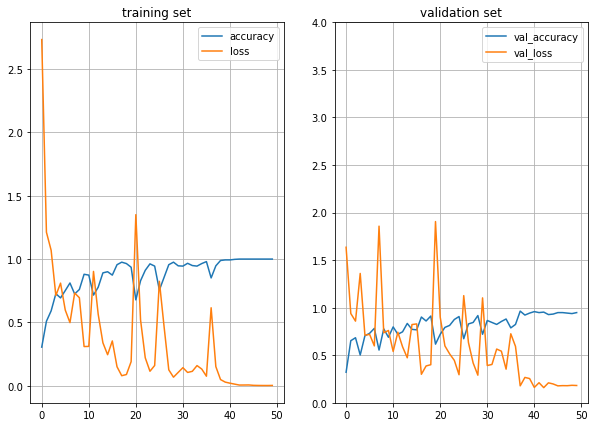

In [14]:
plt.figure(figsize=(10,7))
plt.subplot(1,2,1)
plt.plot(hist.history['accuracy'],label='accuracy')
plt.plot(hist.history['loss'],label='loss')
plt.legend()
plt.title("training set")
plt.grid()
plt.subplot(1,2,2)
plt.plot(hist.history['val_accuracy'],label='val_accuracy')
plt.plot(hist.history['val_loss'],label='val_loss')
plt.legend()
plt.title("validation set")
plt.grid()
plt.ylim((0,4))

# Test set accuracy

In [15]:
score = vggmodel.evaluate(dx_test,y_test)
print("accuracy: ", score[1])

6/6 [==============================] - 0s 66ms/step - loss: 0.2316 - accuracy: 0.9441
accuracy:  0.9440993666648865


In [16]:
pred = vggmodel.predict(dx_test)
prediction = np.argmax(pred,axis=1)
true = np.argmax(y_test,axis=1)
best_prob = [pred[num,:][i] for num,i in enumerate(prediction)]

# Confusion matrix

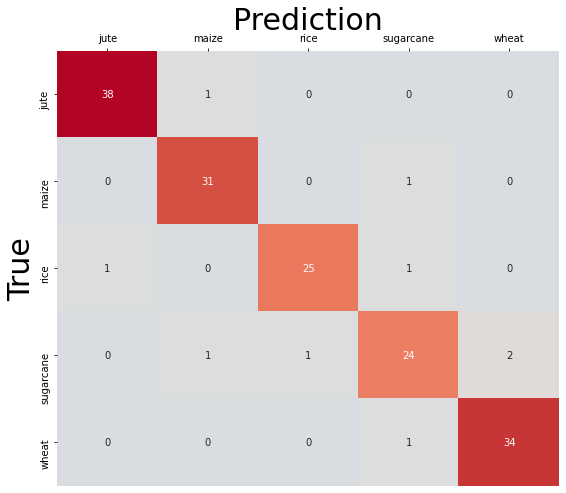

In [17]:
plt.figure(figsize = (9,8))
class_label = ['jute','maize','rice','sugarcane','wheat']
fig = sns.heatmap(confusion_matrix(true,prediction),cmap= "coolwarm",annot=True,vmin=0,cbar = False,
            center = True,xticklabels=class_label,yticklabels=class_label)
fig.set_xlabel("Prediction",fontsize=30)
fig.xaxis.set_label_position('top')
fig.set_ylabel("True",fontsize=30)
fig.xaxis.tick_top()

# Pipelining

In [18]:
def deepmodelpipeline(imagepath,model = vggmodel,label=[-1]):
    pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    pred_x = deep_pipeline([imagepath])
    prediction = model.predict(pred_x)
    pred = np.argmax(prediction[0])
    plt.imshow(plt.imread(imagepath))
    if (label[0]!=-1):
        plt.title("prediction : {0} % {1:.2f} \ntrue        : {2}".format(pdict[pred],prediction[0,pred]*100,pdict[np.argmax(label)]))
    else:
        plt.title("prediction : {0}, % {1:.2f}".format(pdict[pred],prediction[0,pred]*100))

# Prediction on sample images

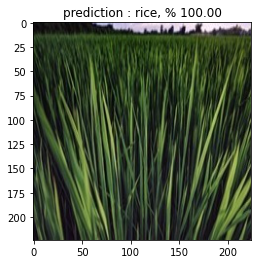

In [19]:
deepmodelpipeline('/kaggle/input/agriculture-crop-images/kag2/rice/rice024ahs.jpeg')

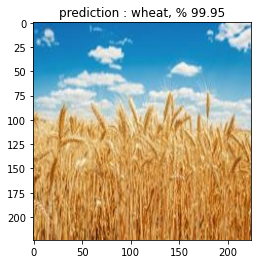

In [20]:
deepmodelpipeline('../input/agriculture-crop-images/kag2/wheat/wheat0004a.jpeg')

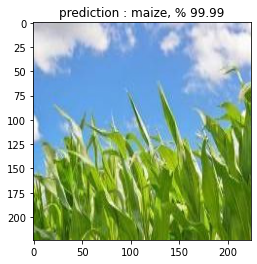

In [21]:
deepmodelpipeline("../input/agriculture-crop-images/kag2/maize/maize008ahf.jpeg")

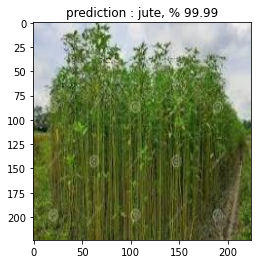

In [22]:
deepmodelpipeline("../input/agriculture-crop-images/kag2/jute/jute005a.jpeg")

# Prediction on test images

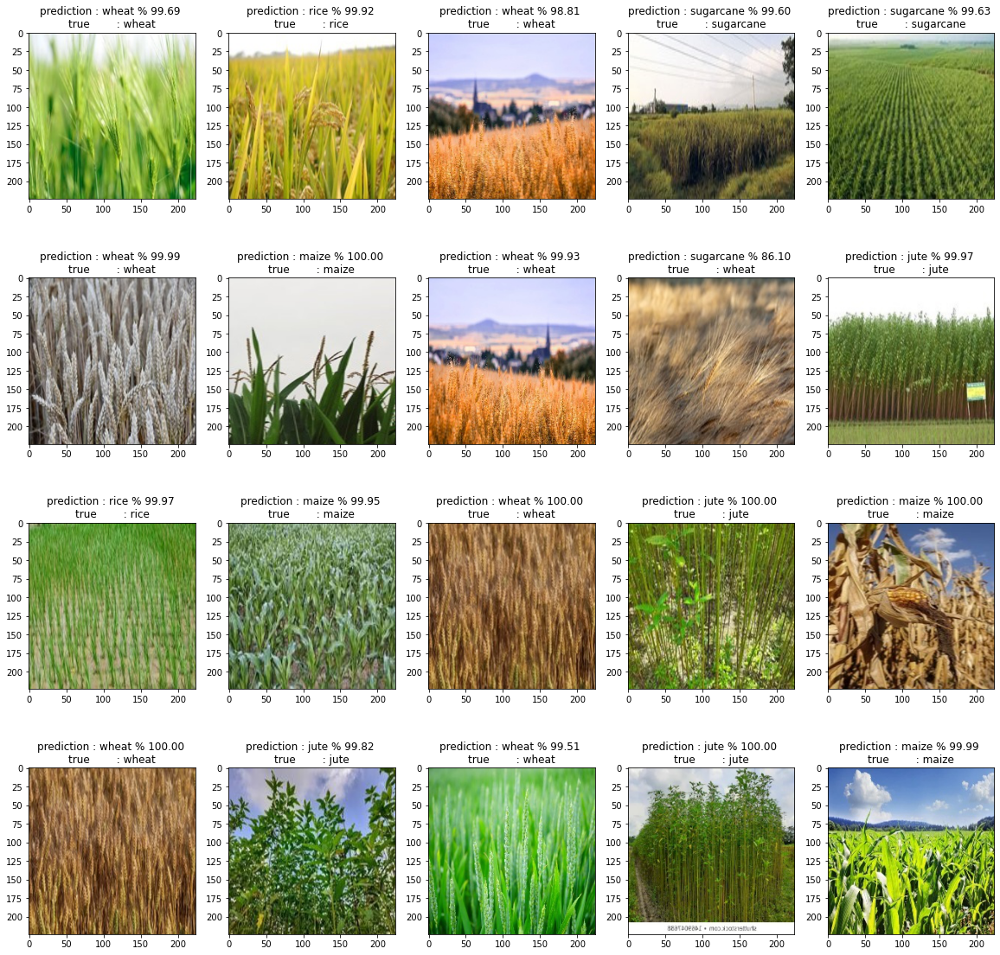

In [23]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[0:20]):
    plt.subplot(4,5,num+1)
    deepmodelpipeline(path,vggmodel,y_test[num])

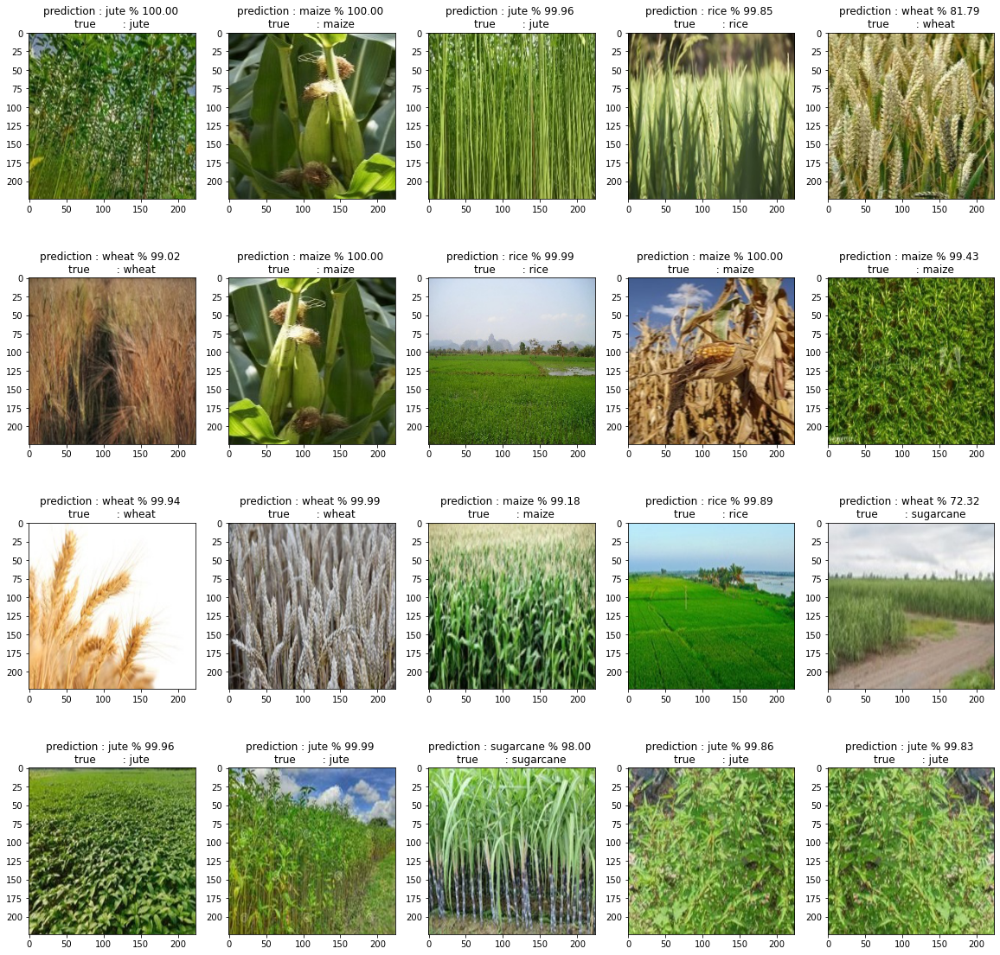

In [24]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[20:40]):
    plt.subplot(4,5,num+1)
    deepmodelpipeline(path,vggmodel,y_test[num+20])

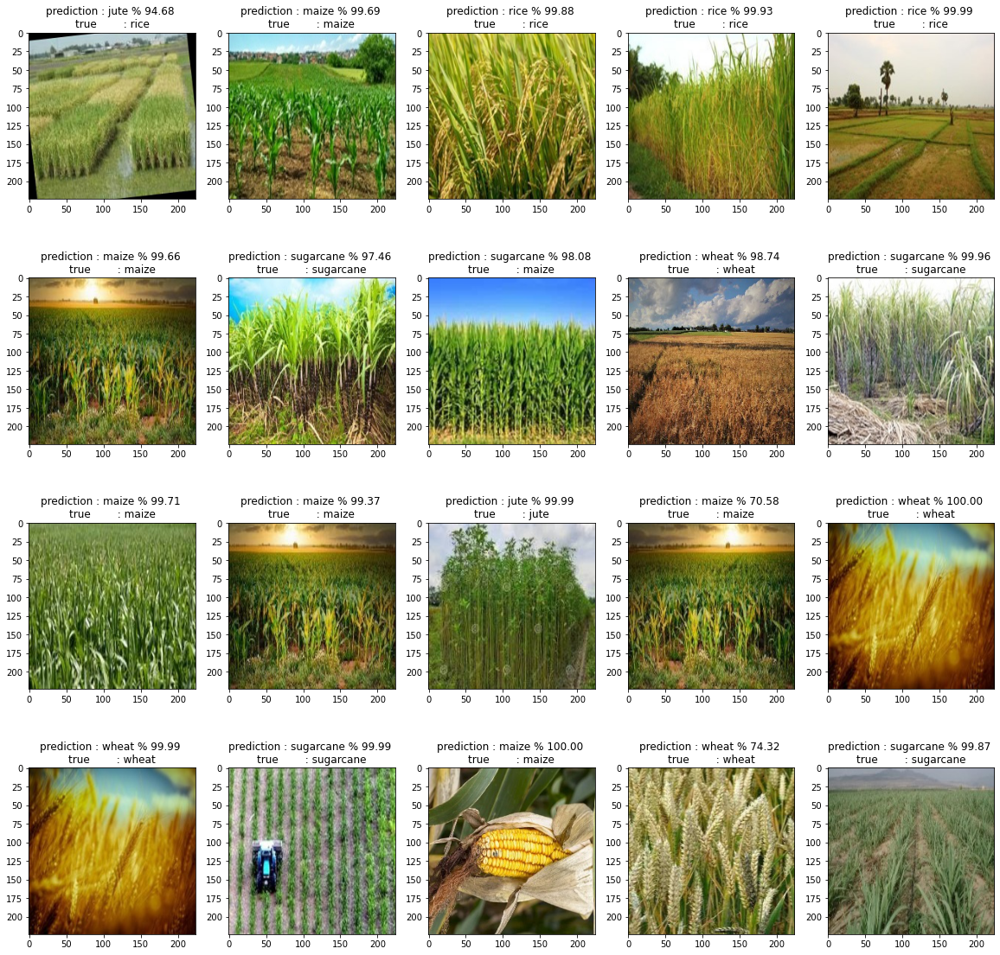

In [25]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[40:60]):
    plt.subplot(4,5,num+1)
    deepmodelpipeline(path,vggmodel,y_test[num+40])

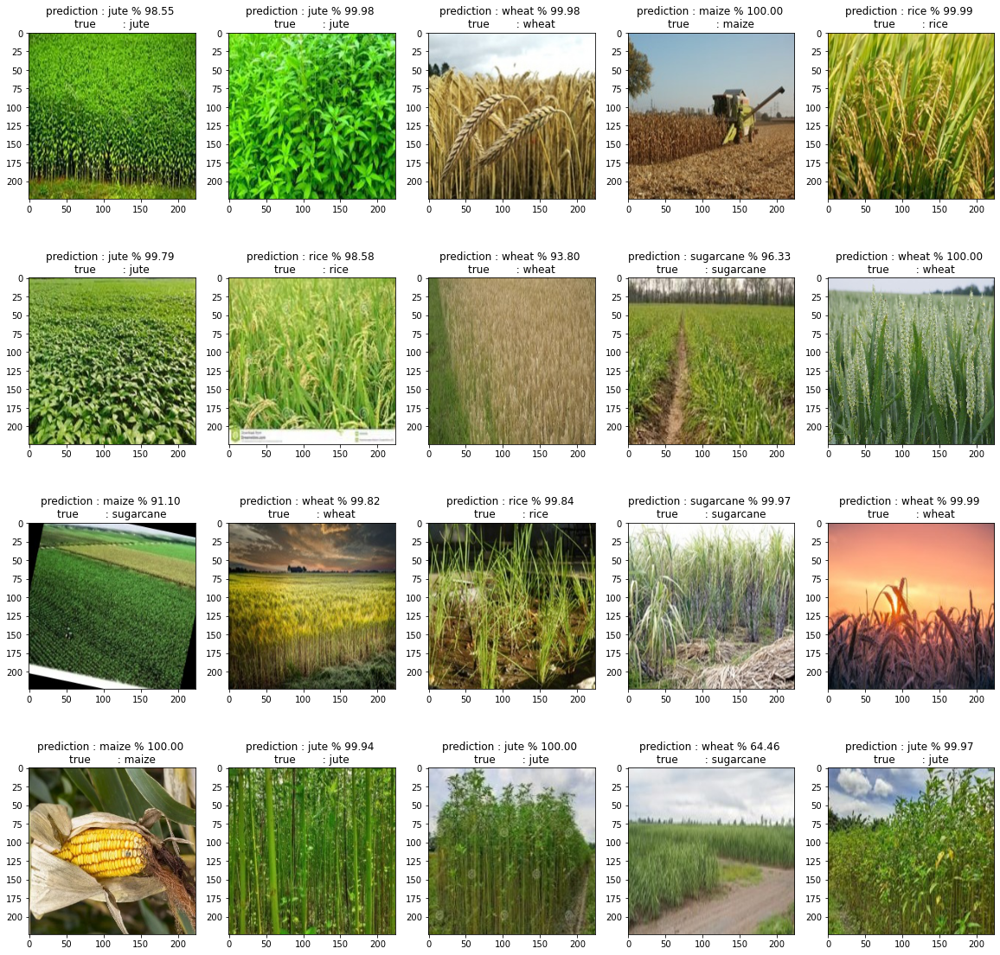

In [26]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[100:120]):
    plt.subplot(4,5,num+1)
    deepmodelpipeline(path,vggmodel,y_test[num+100])

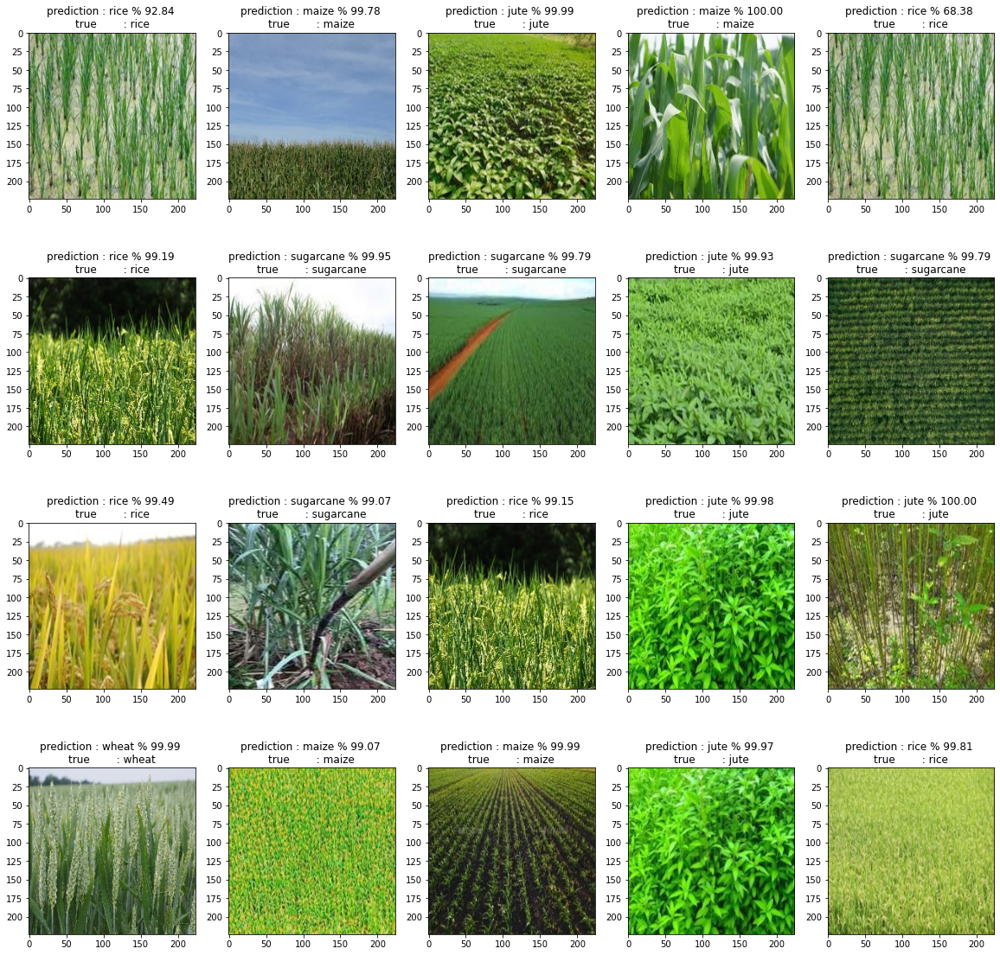

In [27]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[140:160]):
    plt.subplot(4,5,num+1)
    deepmodelpipeline(path,vggmodel,y_test[num+140])

# Saving Model

In [28]:
vggmodel.save_weights("vggmodelweight.h5")

# <font color = "red"> If you like this kernel. Then appreciate me with an upvote</font>

# EVALUATING MODEL ON TESTSSSS DATASET IMAGES

## Loading necessary preprocessing functions

In [29]:
def resize_image(image_array):
    return cv2.resize(image_array,(224,224))
def rescale_image(image_array):
    return image_array*1./255
def read_image(image_path):
    return plt.imread(image_path)
def plot_image(image_array):
    try:
        plt.imshow(image_array)
    except:
        plt.imshow(image_array[0])
def preprocess_image(image_path,reshape = True):
    image = read_image(image_path)
    image = resize_image(image)
    image = rescale_image(image)
    if(reshape ==  True):
        image = image.reshape(-1,image.shape[0],image.shape[1],image.shape[2])    
    return image
def preprocess_imageslist(image_list):
    imagelist = np.array([preprocess_image(img,reshape=False) for img in image_list])
    return imagelist
def predict_and_plot(image,model):
    pred_dict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    plt.imshow(image[0])
    prediction = model.predict(image) 
    pred = pred_dict[np.argmax(prediction)]
    plt.title(pred)
%matplotlib inline
def predict_and_plot5(imagelist,model):
    pred_dict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    plt.figure(figsize=(20,10))
    for num,image in enumerate(imagelist):
        plt.subplot(1,5,num+1)
        plt.imshow(image)
        prediction = model.predict(image.reshape(-1,224,224,3)) 
        pred = pred_dict[np.argmax(prediction)]
        plt.title(pred)
def predict_and_plot51(imagelist,model):
    pred_dict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    plt.figure(figsize=(100,10))
    for i in range(0,55,5):
        predict_and_plot5(imagelist[i:i+5],vggmodel)
def predict_and_plot30(imagelist,model):
    plt.figure(figsize=(40,10))
    for i in range(0,len(imagelist),5):
        predict_and_plot5(imagelist[i:i+5],vggmodel)

In [30]:
testdata = pd.read_csv('../input/testssss/testdata.csv')

In [31]:
imagepath = testdata['testpath'].values
true_label = testdata['croplabel'].values
testdata.head()

,Unnamed: 0,testpath,crop,croplabel
0,0,/kaggle/input/testssss/test_crop_image/wheat-f...,wheat,4
1,1,/kaggle/input/testssss/test_crop_image/jute-fi...,jute,0
2,2,/kaggle/input/testssss/test_crop_image/wheat-c...,wheat,4
3,3,/kaggle/input/testssss/test_crop_image/maize00...,maize,1
4,4,/kaggle/input/testssss/test_crop_image/rice-fi...,rice,2


In [32]:
process_image = preprocess_imageslist(imagepath)

<Figure size 7200x720 with 0 Axes>

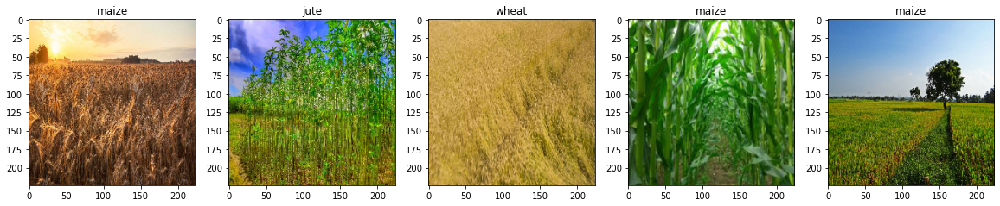

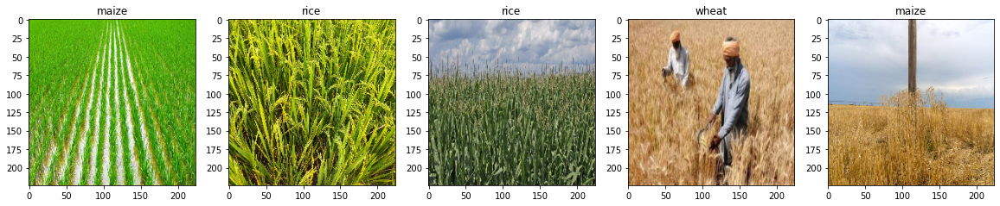

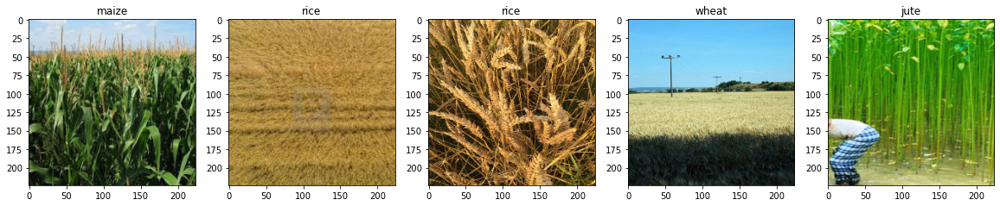

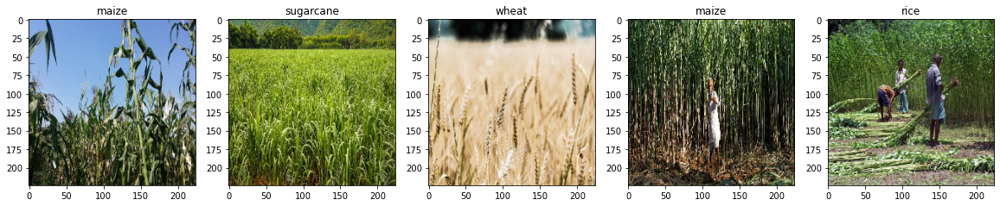

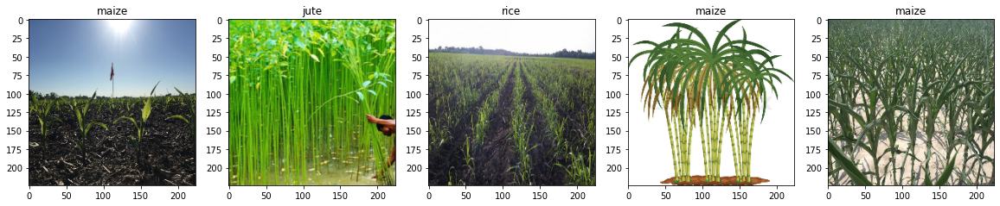

...

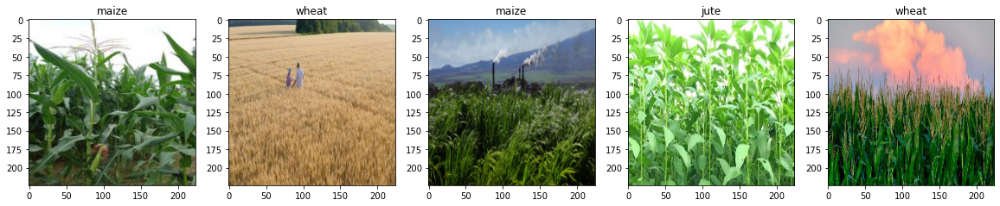

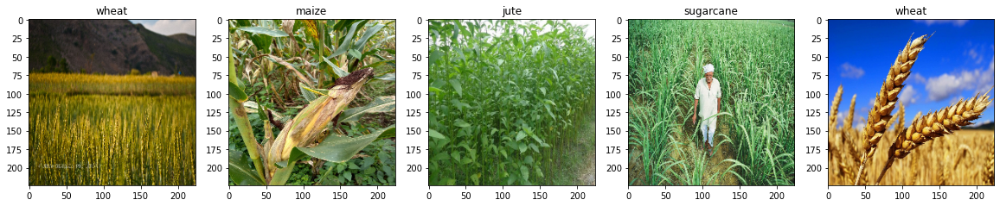

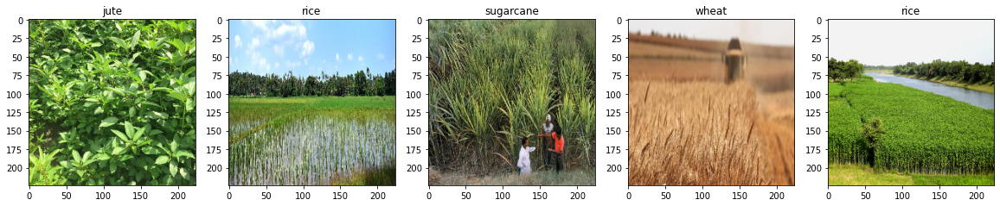

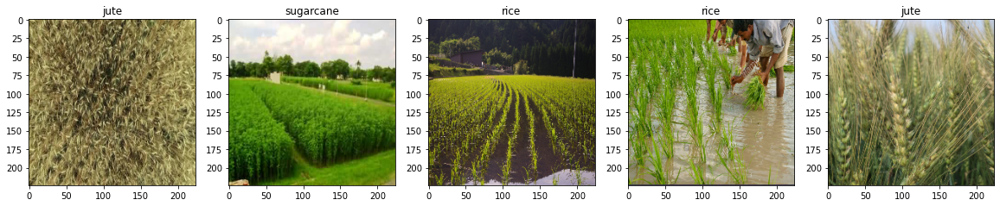

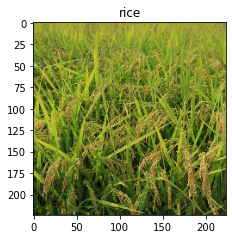

In [33]:
predict_and_plot51(process_image,model=vggmodel)

In [34]:
test_prediction = np.argmax(vggmodel.predict(process_image),axis=1)

In [35]:
accuracy_score(true_label,test_prediction)

0.6274509803921569

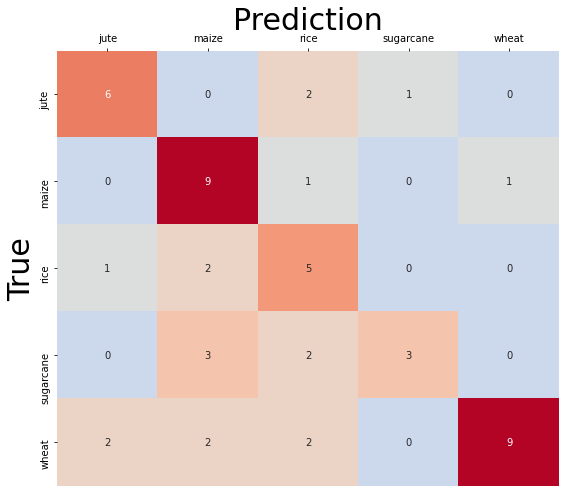

In [36]:
plt.figure(figsize = (9,8))
class_label = ['jute','maize','rice','sugarcane','wheat']
fig = sns.heatmap(confusion_matrix(true_label,test_prediction),cmap= "coolwarm",annot=True,vmin=0,cbar = False,
            center = True,xticklabels=class_label,yticklabels=class_label)
fig.set_xlabel("Prediction",fontsize=30)
fig.xaxis.set_label_position('top')
fig.set_ylabel("True",fontsize=30)
fig.xaxis.tick_top()

In [37]:
classify = true_label==test_prediction
wrong_classify = [num for num,p in enumerate(classify) if p==False]
correct_classify = [num for num,p in enumerate(classify) if p==True]

In [38]:
correct_class_image = process_image[correct_classify]
wrong_class_image = process_image[wrong_classify]

# Wrong classified Images

<Figure size 2880x720 with 0 Axes>

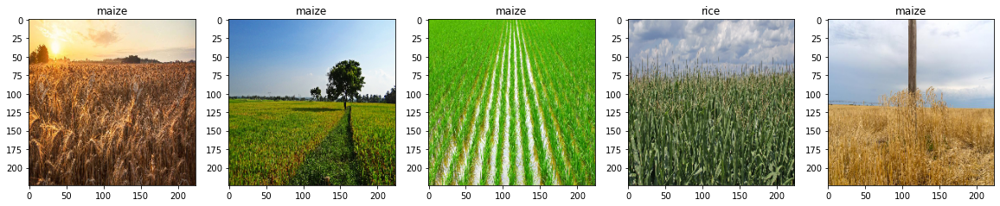

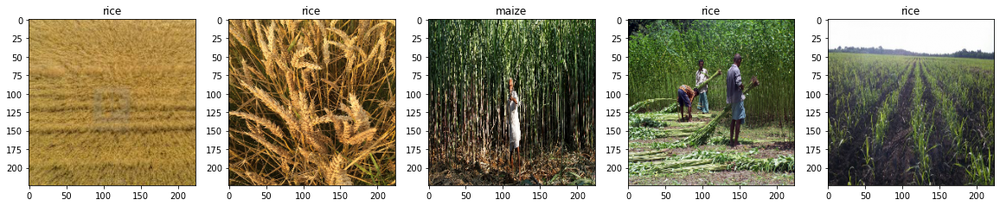

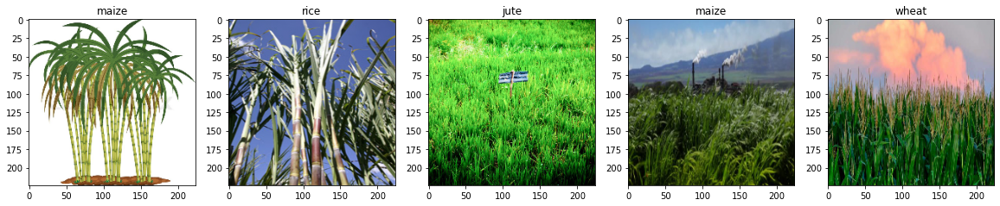

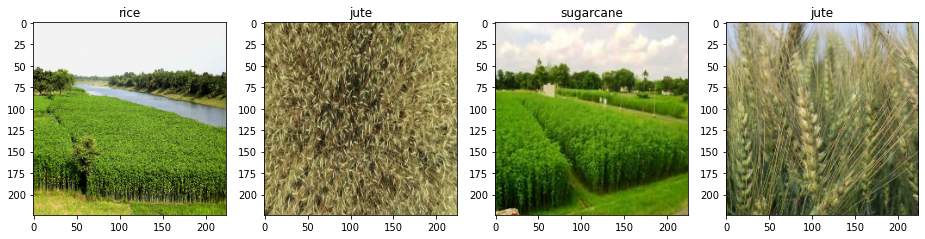

In [39]:
predict_and_plot30(wrong_class_image,vggmodel)

# Correct Classified Images

<Figure size 2880x720 with 0 Axes>

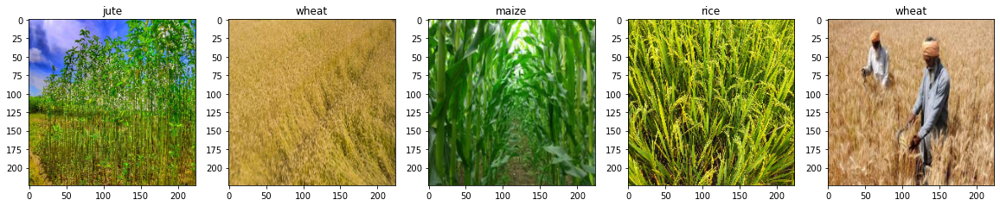

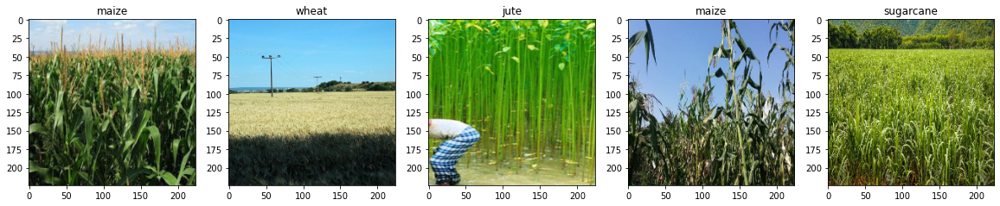

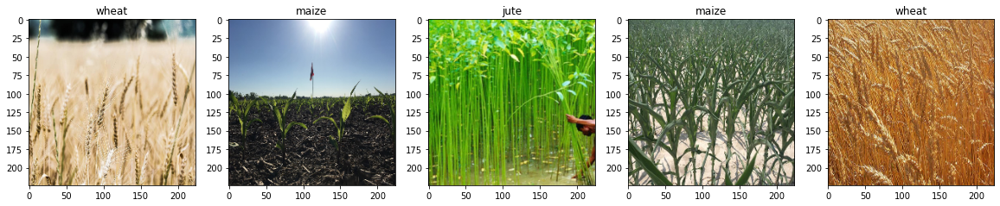

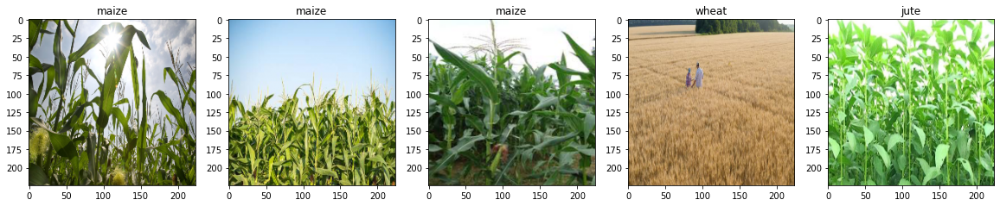

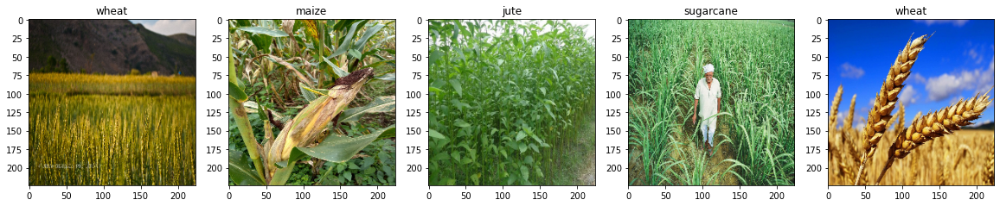

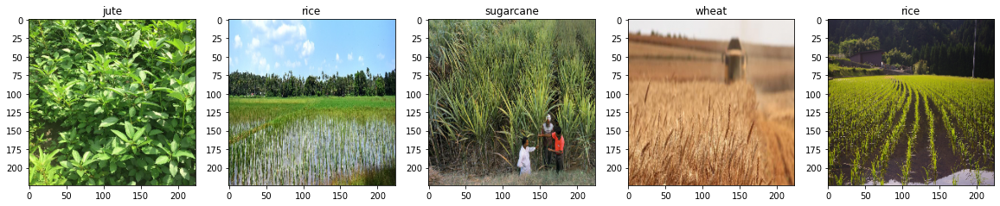

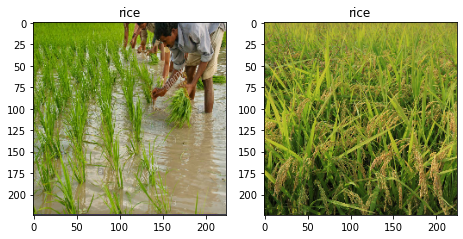

In [40]:
predict_and_plot30(correct_class_image,vggmodel)

# Creating dataframe to submit testssss data prediction

In [41]:
labels = test_prediction.reshape(-1,1)
imagepath = imagepath.reshape(-1,1)
df = pd.DataFrame(np.append(imagepath,labels,axis=1),columns=['pathname','label'])
df.head()

,pathname,label
0,/kaggle/input/testssss/test_crop_image/wheat-f...,1
1,/kaggle/input/testssss/test_crop_image/jute-fi...,0
2,/kaggle/input/testssss/test_crop_image/wheat-c...,4
3,/kaggle/input/testssss/test_crop_image/maize00...,1
4,/kaggle/input/testssss/test_crop_image/rice-fi...,1


In [42]:
df.to_csv('submission.csv')

# Enter your path of your image You want to predict


**first upload image through add data**

In [43]:
get_image_path = "../input/testssss/test_crop_image/jute-field.jpg"

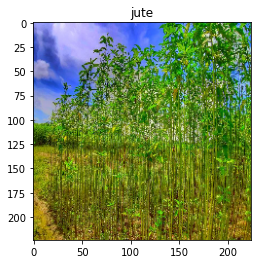

In [44]:
image1 = preprocess_image(get_image_path)
predict_and_plot(image1,model = vggmodel)

# <font color = "red"> If you like this kernel. Then appreciate me with an upvote</font>